<a href="https://colab.research.google.com/github/amcheyre-nw/image_mosaic_CV/blob/main/image_mosaic_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install opencv-contrib-python==3.4.2.17

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
import matplotlib.lines as mlines
import math
import os
from scipy import optimize
from timeit import default_timer as timer
from google.colab.patches import cv2_imshow

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
files_dir = '/content/drive/MyDrive/CV_Project/Input_images'

Pipeline:

1. compositing
2. feature extraction
3. feature matching
4. panorama recognizing
5. mosaic images
6. image blending

In [ ]:
class FeatureExtractor:
    def __init__(self, type='SIFT'):
        if type=='SIFT':
            self.extractor = cv2.xfeatures2d.SIFT_create()
        elif type=='SURF':
            self.extractor = cv2.xfeatures2d.SURF_create()
        elif type=='ORB':
            self.extractor = cv2.ORB_create()
        else:
            raise typeError("Error, unknown feature type!")

    def getFeatures(self, img):
        kp, des = self.extractor.detectAndCompute(img, None)
        return kp, des

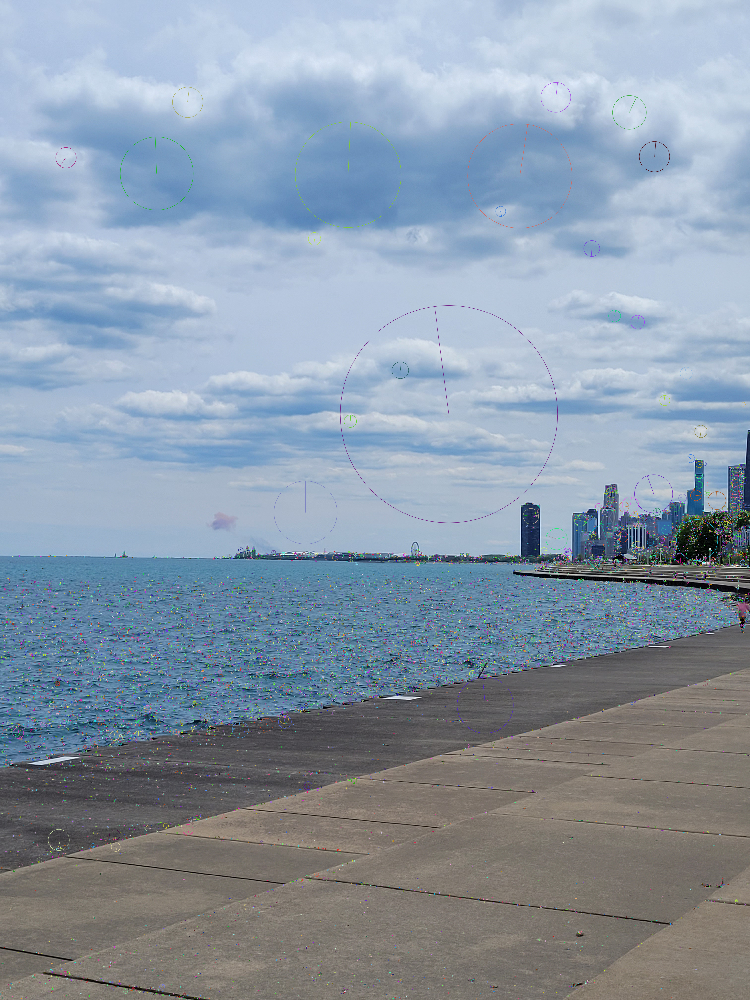

In [ ]:
img = cv2.imread('/content/drive/MyDrive/CV_Project/Input_images/Image_1/1.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# extractor = FeatureExtractor('SURF')
extractor = FeatureExtractor('SIFT')
kp, des = extractor.getFeatures(gray)
labeled_img = cv2.drawKeypoints(img, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2_imshow(labeled_img)
cv2.waitKey()
cv2.destroyAllWindows()

In [18]:
MIN_MATCH_COUNT = 10
FLANN_INDEX_KDTREE = 0
LOWES_RATIO = 0.5

In [19]:
class FeatureMatcher:
    def __init__(self):
        index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
        search_params = dict(checks = 50)
        self.matcher = cv2.FlannBasedMatcher(index_params, search_params)

    def match(self, des1, des2):
        matches = self.matcher.knnMatch(des2, des1, k=2)

        # store all the good matches as per Lowe's ratio test.
        good = []
        for m, n in matches:
            if m.distance < LOWES_RATIO*n.distance:
                good.append(m)

        return good

    def getTransform(self, kp1, kp2, des1, des2, good=None, type='homography'):
        if good is None:
            good = self.match(des1, des2)

        if len(good)>MIN_MATCH_COUNT:
            src_pts = np.float32([ kp2[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
            dst_pts = np.float32([ kp1[m.trainIdx].pt for m in good ]).reshape(-1,1,2)

            if type=='homography':
                M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0)

            if type=='affine':
                M, mask = cv2.estimateAffine2D(src_pts, dst_pts, cv2.RANSAC, ransacReprojThreshold=5.0)
                M = np.append(M, [[0,0,1]], axis=0)

            # matchesMask = mask.ravel().tolist()
        else:
            print("Not enough matches are found - %d/%d" % (len(good), MIN_MATCH_COUNT))
            M, mask = None, None

        return M, mask

In [21]:
# load images
img1 = cv2.imread('/content/drive/MyDrive/CV_Project/Input_images/Image_1/1.jpg')
img2 = cv2.imread('/content/drive/MyDrive/CV_Project/Input_images/Image_1/2.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

# extract features from images
extractor = FeatureExtractor()
kp1, des1 = extractor.getFeatures(gray1)
kp2, des2 = extractor.getFeatures(gray2)

# matches feature and get homography
matcher = FeatureMatcher()
H, _ = matcher.getTransform(kp1, kp2, des1, des2)

# display the results
print("Homography matrix:")
print(H)
print("%d good matched points found." % len(matcher.match(des1, des2)))

Homography matrix:
[[ 8.50968357e-01  9.40598713e-03  1.44269932e+03]
 [-1.07245918e-01  9.54849361e-01  1.28414739e+02]
 [-4.80857839e-05 -1.72232912e-06  1.00000000e+00]]
789 good matched points found.


In [22]:
'''
Warp an image from cartesian coordinates (x, y) into cylindrical coordinates (theta, h)
Returns: (image, mask)
Mask is [0,255], and has 255s wherever the cylindrical images has a valid value.
Masks are useful for stitching
Usage example:
    im = cv2.imread("myimage.jpg",0) #grayscale
    h,w = im.shape
    f = 700
    K = np.array([[f, 0, w/2], [0, f, h/2], [0, 0, 1]]) # mock calibration matrix
    imcyl = cylindricalWarpImage(im, K)
'''
def cylindricalWarpImage(img1, K, savefig=False):
    f = K[0,0]

    im_h,im_w = img1.shape[:2]

    # go inverse from cylindrical coord to the image
    # (this way there are no gaps)
    cyl = np.zeros_like(img1)
    cyl_mask = np.zeros((im_h,im_w), dtype=img1.dtype)
    cyl_h, cyl_w = cyl.shape[:2]
    x_c = float(cyl_w) / 2.0
    y_c = float(cyl_h) / 2.0
    for x_cyl in np.arange(0,cyl_w):
        for y_cyl in np.arange(0,cyl_h):
            theta = (x_cyl - x_c) / f
            h     = (y_cyl - y_c) / f

            X = np.array([math.sin(theta), h, math.cos(theta)])
            X = np.dot(K,X)
            x_im = X[0] / X[2]
            if x_im < 0 or x_im >= im_w:
                continue

            y_im = X[1] / X[2]
            if y_im < 0 or y_im >= im_h:
                continue

            cyl[int(y_cyl),int(x_cyl)] = img1[int(y_im),int(x_im)]
            cyl_mask[int(y_cyl),int(x_cyl)] = 255


    if savefig:
        plt.imshow(cyl, cmap='gray')
        plt.savefig("cyl.png",bbox_inches='tight')

    return (cyl, cyl_mask)

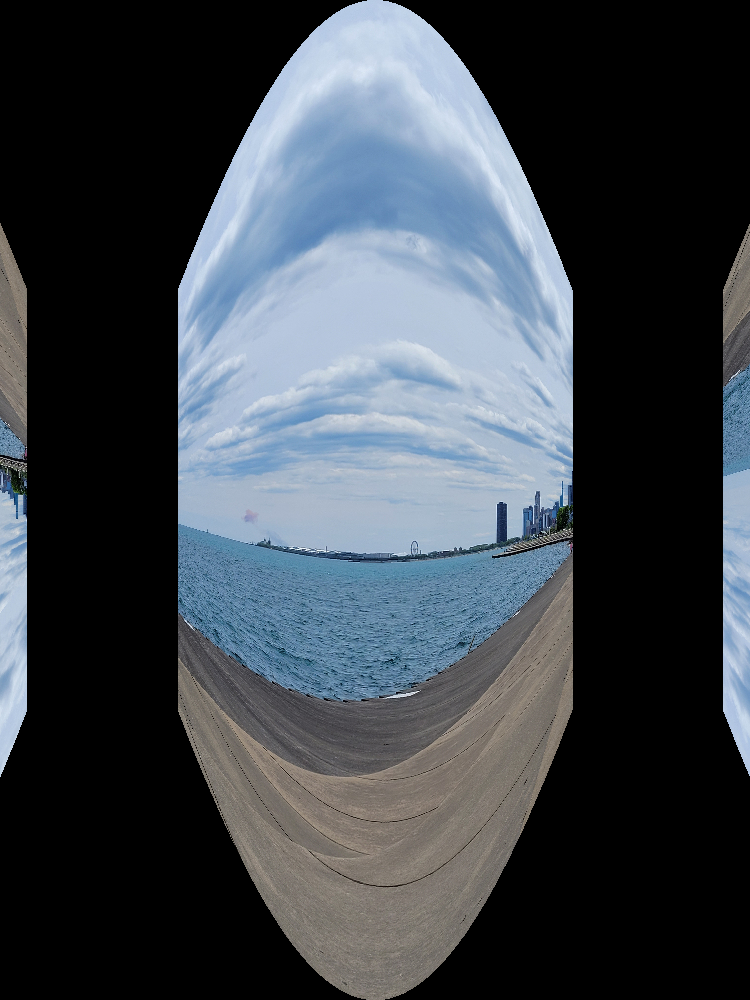

In [23]:
im = cv2.imread('/content/drive/MyDrive/CV_Project/Input_images/Image_1/1.jpg')
h,w = im.shape[:2]
f = 700
K = np.array([[f, 0, w/2], [0, f, h/2], [0, 0, 1]]) # mock calibration matrix
imcyl = cylindricalWarpImage(im, K)

cv2_imshow(imcyl[0])
cv2.waitKey()
cv2.destroyAllWindows()

In [24]:
def warpLocal(src, uv):
    '''
    Input:
        src --    source image in a numpy array with values in [0, 255].
                  The dimensions are (rows, cols, color bands BGR).
        uv --     warped image in terms of addresses of each pixel in the source
                  image in a numpy array.
                  The dimensions are (rows, cols, addresses of pixels [:,:,0]
                  are x (i.e., cols) and [:,,:,1] are y (i.e., rows)).
    Output:
        warped -- resampled image from the source image according to provided
                  addresses in a numpy array with values in [0, 255]. The
                  dimensions are (rows, cols, color bands BGR).
    '''
    width = src.shape[1]
    height  = src.shape[0]
    mask = cv2.inRange(uv[:,:,1],0,height-1)&cv2.inRange(uv[:,:,0],0,width-1)
    warped = cv2.remap(src, uv[:, :, 0].astype(np.float32),\
             uv[:, :, 1].astype(np.float32), cv2.INTER_LINEAR, borderMode=cv2.BORDER_REPLICATE)
    img2_fg = cv2.bitwise_and(warped,warped,mask = mask)
    return img2_fg, mask

In [25]:
def computeSphericalWarpMappings(dstShape, f, k1, k2):
    '''
    Compute the spherical warp. Compute the addresses of each pixel of the
    output image in the source image.
    Input:
        dstShape -- shape of input / output image in a numpy array.
                    [number or rows, number of cols, number of bands]
        f --        focal length in pixel as int
                    See assignment description on how to find the focal length
        k1 --       horizontal distortion as a float
        k2 --       vertical distortion as a float
    Output:
        uvImg --    warped image in terms of addresses of each pixel in the
                    source image in a numpy array.
                    The dimensions are (rows, cols, addresses of pixels
                    [:,:,0] are x (i.e., cols) and [:,:,1] are y (i.e., rows)).
    '''

    # calculate minimum y value
    vec = np.zeros(3)
    vec[0] = np.sin(0.0) * np.cos(0.0)
    vec[1] = np.sin(0.0)
    vec[2] = np.cos(0.0) * np.cos(0.0)
    min_y = vec[1]

    # calculate spherical coordinates
    # (x,y) is the spherical image coordinates.
    # (xf,yf) is the spherical coordinates, e.g., xf is the angle theta
    # and yf is the angle phi
    one = np.ones((dstShape[0], dstShape[1]))
    xf = one * np.arange(dstShape[1])
    yf = one.T * np.arange(dstShape[0])
    yf = yf.T

    xf = ((xf - 0.5 * dstShape[1]) / f)
    yf = ((yf - 0.5 * dstShape[0]) / f - min_y)
    # BEGIN TODO 1
    # add code to apply the spherical correction, i.e.,
    # compute the Euclidean coordinates,
    # and project the point to the z=1 plane at (xt/zt,yt/zt,1),
    # then distort with radial distortion coefficients k1 and k2
    # Use xf, yf as input for your code block and compute xt, yt
    # as output for your code. They should all have the shape
    # (img_height, img_width)
    # TODO-BLOCK-BEGIN
    a = np.sin(xf) * np.cos(yf)
    b = np.sin(yf)
    c = np.cos(xf) * np.cos(yf)

    x_ = a / c
    y_ = b / c

    r = x_ ** 2 + y_ ** 2
    xt = x_ * (1 + k1 * r + k2 * r * r)
    yt = y_ * (1 + k1 * r + k2 * r * r)

    # TODO-BLOCK-END
    # END TODO
    # Convert back to regular pixel coordinates
    xn = 0.5 * dstShape[1] + xt * f
    yn = 0.5 * dstShape[0] + yt * f
    uvImg = np.dstack((xn,yn))
    return uvImg

In [26]:
def warpSpherical(image, focalLength, k1=-0.21, k2=0.26):
    '''
    Input:
        image --       filename of input image as string
        focalLength -- focal length in pixel as int
                       see assignment description on how to find the focal
                       length
        k1, k2 --      Radial distortion parameters
    Output:
        dstImage --    output image in a numpy array with
                       values in [0, 255]. The dimensions are (rows, cols,
                       color bands BGR).
    '''

    # compute spherical warp
    # compute the addresses of each pixel of the output image in the
    # source image
    uv = computeSphericalWarpMappings(np.array(image.shape), focalLength, k1, \
        k2)

    # warp image based on backwards coordinates
    return warpLocal(image, uv)

mask shape: (4032, 3024)
mask dtype: uint8


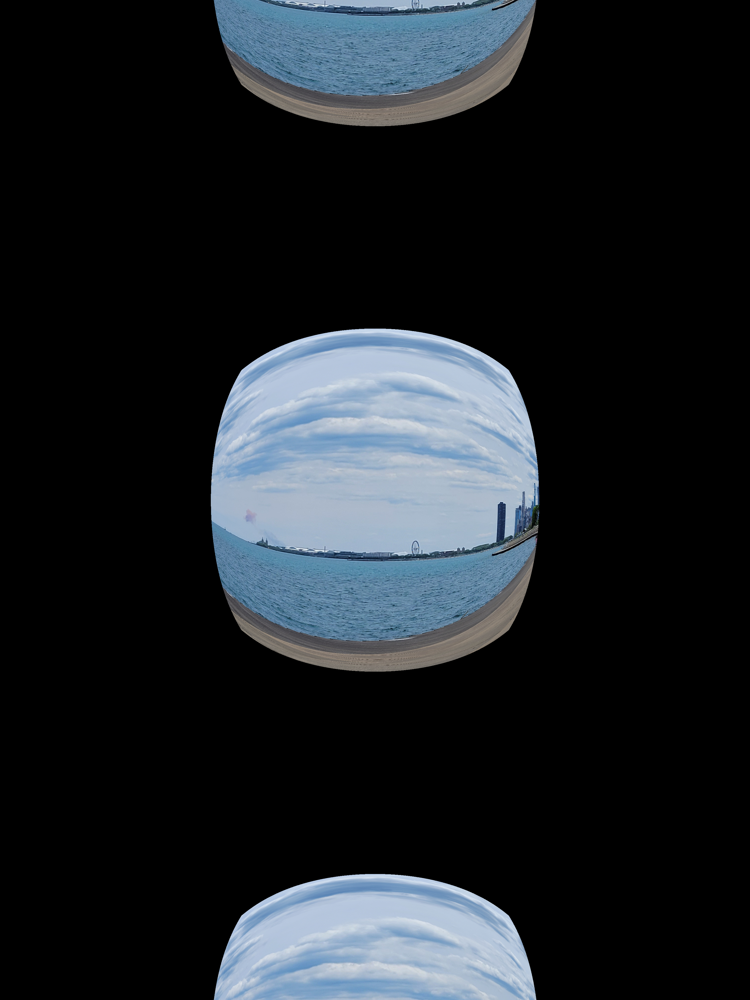

In [27]:
im = cv2.imread('/content/drive/MyDrive/CV_Project/Input_images/Image_1/1.jpg')
# h,w = im.shape[:2]
f = 700
# K = np.array([[f, 0, w/2], [0, f, h/2], [0, 0, 1]]) # mock calibration matrix

# focalLength = float(self.focalLengthEntry.get())
# k1 = self.getK1()
# k2 = self.getK2()
warpedImage, mask = warpSpherical(im, f)
print("mask shape:", mask.shape)
print("mask dtype:", mask.dtype)

# imcyl = cylindricalWarpImage(im, K)

cv2_imshow(warpedImage)
cv2.waitKey()
cv2.destroyAllWindows()

In [28]:
class Stitcher:
    def __init__(self, image_names=[], f=800, mode='Spherical'):
        self.__images = []
        self.__image_masks = []
        self.__features = []
        self.__image_pairs = []
        self.__start = None
        self.extractor = FeatureExtractor()
        self.matcher = FeatureMatcher()

        for image_name in image_names:
            img = cv2.imread(image_name)

            if mode=='Cylindrical':
                self.__transform_method = 'affine'
                #### convert rectangler to cylindrical
                h,w = img.shape[:2]
                start=timer()
                K = np.array([[f, 0, w/2], [0, f, h/2], [0, 0, 1]]) # mock calibration matrix
                cylindrical_img, cylindrical_mask = cylindricalWarpImage(img, K)
                end=timer()
                print("convert time", end-start)
                print("converting", image_name, "to cylindrical ... ")
                # print("cylindrical mask dtype:", cylindrical_mask.dtype)
                # print("cylindrical mask shape:", cylindrical_mask.shape)

                self.__images.append(cylindrical_img)
                self.__image_masks.append(cylindrical_mask)

            if mode=='Spherical':
                self.__transform_method = 'affine'
                #### convert rectangler to spherical
                # f = 3000
                start=timer()
                spherical_img, spherical_mask = warpSpherical(img, f)
                end=timer()
                print("convert time", end-start)
                print("converting", image_name, "to spherical ... ")

                self.__images.append(spherical_img)
                self.__image_masks.append(spherical_mask)

            if mode=='Flat':
                self.__transform_method = 'homography'
                #### flat
                self.__images.append(img)
                self.__image_masks.append(np.ones(img.shape[:2], dtype=np.uint8)*255)

    def prepare_features(self):
        self.__features = []
        for i in range(len(self.__images)):
            # convert images to grayscale
            gray = cv2.cvtColor(self.__images[i], cv2.COLOR_RGB2GRAY)

            # extract features from images
            kp, des = self.extractor.getFeatures(gray)

            # store features
            feature = dict(kp=kp, des=des)
            self.__features.append(feature)

    def is_all_connected(self, all_nodes, connection, s, nodes_visited=set()):
        nodes_visited.add(s)
        for node in connection[s]:
            if node not in nodes_visited:
                self.is_all_connected(all_nodes, connection, node, nodes_visited)

        # print("nodes_visited in is_all_connected", nodes_visited)
        # print("all_nodes in is_all_connected", all_nodes)
        # print("edges in is_all_connected", connection)
        if nodes_visited==all_nodes:
            return True
        else:
            return False

    def bfs_find_pairs(self, connection, s, good_matrix, nodes_visited=set()):
        nodes_visited.add(s)
        for node in connection[s]:
            if node not in nodes_visited:
                pair_details = dict(src_index=s,
                                    dst_index=node,
                                    good_matched_points=good_matrix[s][node])
                self.__image_pairs.append(pair_details)
                self.bfs_find_pairs(connection, node, good_matrix, nodes_visited)

    def find_most_pair_two_images(self):
        #### prepare features
        if self.__features == []:
            self.prepare_features()

        #### initializa
        pair_matrix = np.zeros((len(self.__images), len(self.__images)))
        good_matrix = [[ None for _ in range(len(self.__images))]
                       for _ in range(len(self.__images))]

        #### find matches amount matrix
        print("matching features ...")
        for pre_i in range(len(self.__images)):
            for i in range(len(self.__images)):
                if pre_i==i:
                    continue

                print("matching features on image %d and image %d ..." % (pre_i, i))

                # matches feature
                # good = self.matcher.match(
                #     self.__features[pre_i]['des'], self.__features[i]['des']) # ->
                good = self.matcher.match(
                    self.__features[i]['des'], self.__features[pre_i]['des'])
                pair_matrix[pre_i, i] = len(good)
                good_matrix[pre_i][i] = good

        # print(pair_matrix)

        #### find the most pair image relationship
        image_number = len(pair_matrix)
        maximum_index = np.argmax(pair_matrix)
        row = maximum_index // image_number
        col = maximum_index % image_number
        # print("maximum_index =", maximum_index, "len(pair_matrix) =", image_number)
        # print("row =", row, "col =", col)
        # print("The maximum value is", pair_matrix[row][col])

        pair_matrix[row][col] = -1

        all_nodes = set([i for i in range(image_number)])
        nodes = set()
        nodes.add(row)
        nodes.add(col)

        edges = {}
        edges[row] = set()
        edges[row].add(col)
        edges[col] = set()
        edges[col].add(row)

        # print("all_nodes =", all_nodes)
        # print("nodes =", nodes)
        # print("edges =", edges)

        self.__start = row
        # print("Is a closed tree?", self.is_all_connected(all_nodes, edges, self.__start))
        while not self.is_all_connected(all_nodes, edges, self.__start, set()):
            maximum_index = np.argmax(pair_matrix)
            row = maximum_index // image_number
            col = maximum_index % image_number
            # print()
            # print("maximum_index =", maximum_index, "len(pair_matrix) =", image_number)
            # print("row =", row, "col =", col)
            # print("The maximum value is", pair_matrix[row][col])

            pair_matrix[row][col] = -1

            if row not in nodes:
                edges[row] = set()
            if col not in nodes:
                edges[col] = set()
            edges[row].add(col)
            edges[col].add(row)

            nodes.add(row)
            nodes.add(col)

            # print("all_nodes =", all_nodes)
            # print("nodes =", nodes)
            # print("edges =", edges)

        # print("Is a closed tree?", self.is_all_connected(all_nodes, edges, self.__start))

        #### construct self.__image_pairs
        self.bfs_find_pairs(edges, self.__start, good_matrix, set())


        # #### find the most pair image relationship (old)
        # pair_amount_sum = np.sum(pair_matrix, axis=1)
        # # print(pair_amount_sum)
        # ordered_index = np.argsort(pair_amount_sum)
        # # ordered_index = np.flip(ordered_index, axis=0)
        # # print(ordered_index)
        # img_index = ordered_index[0]
        # self.__start = img_index
        # for i in range(len(ordered_index)-1):
        #
        #     max_index = np.argmax(pair_matrix[img_index])
        #     # while max_index<i:# max_index in most_pair_image:
        #     #     pair_matrix[img_index][max_index] = 0
        #     #     max_index = np.argmax(pair_matrix[img_index])
        #     most_pair_image[img_index] = max_index
        #     pair_matrix[max_index][img_index] = 0 # avoid linked back
        #     pair_details = dict(src_index=img_index,
        #                         dst_index=max_index,
        #                         good_matched_points=good_matrix[img_index][max_index])
        #     self.__image_pairs.append(pair_details)
        #
        #     # print(pair_matrix)
        #     # print()
        #     img_index = max_index
        # return most_pair_image

    def find_Hs(self):
        # Initialize
        Hs = []
        # prepare pair details
        start = timer()

        if self.__image_pairs == []:
            self.find_most_pair_two_images()
        end = timer()
        print("Find Pair time:",end-start)
        # find Homography matrixes
        for i in range(len(self.__image_pairs)):
            pair = self.__image_pairs[i]
            index1 = pair['src_index']
            index2 = pair['dst_index']
            kp1 = self.__features[index1]['kp']
            kp2 = self.__features[index2]['kp']
            des1 = self.__features[index1]['des']
            des2 = self.__features[index2]['des']

            # get homography
            print("Finding transform for image %d and image %d" % (index1, index2))
            # H, _ = self.matcher.getTransform(kp1, kp2, des1, des2,
            #                                  good=pair['good_matched_points']) # ->
            H, _ = self.matcher.getTransform(kp2, kp1, des2, des1,
                                             good=pair['good_matched_points'],
                                             type=self.__transform_method)

            pair['H'] = H
            Hs.append(H)

        # print(self.__image_pairs)
        return Hs

    def stitch_all(self):
        if self.__start is None or self.__image_pairs==[] or 'H' not in self.__image_pairs[0].keys():
            self.find_Hs()

        shifted_H = np.eye(3)
        img1 = self.__images[self.__start]
        mask1 = self.__image_masks[self.__start]
        shifted_Hs = {}
        shifted_Hs[self.__start] = shifted_H
        print("Start stiching!")
        for i in range(len(self.__image_pairs)):
            pair = self.__image_pairs[i]

            index1 = pair['src_index']
            index2 = pair['dst_index']

            img2 = self.__images[index2]
            mask2 = self.__image_masks[index2]
            print("stiching image %d and image %d" % (index1,index2))


            # H = np.dot(shifted_H, last_H) # ->
            H = np.dot(pair['H'], np.linalg.inv(shifted_Hs[index1])) # <-
            # H = pair['H']


            # img1, shifted_H = self.mix_images(img1, img2, H, type=self.__transform_method) # ->
            img1, mask1, shifted_H = self.mix_images(img2, img1, mask2, mask1, H,
                                                     type=self.__transform_method)

            #### update cumulative translation/transform
            for k, v in shifted_Hs.items():
                shifted_Hs[k] = np.dot(H, shifted_H)
            if index2 not in shifted_Hs.keys():
                shifted_Hs[index2] = shifted_H
            shifted_Hs[index1] = np.dot(H, shifted_H)

        stiched_image = img1
        return stiched_image

    def old_stitch_all(self):
        new_img = None
        for image in self.__images:
            if new_img is None:
                new_img = image
            else:
                # convert images to grayscale
                new_img_gray = cv2.cvtColor(new_img, cv2.COLOR_RGB2GRAY)
                img_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

                # extract features from images
                new_kp, new_des = self.extractor.getFeatures(new_img_gray)
                kp, des = self.extractor.getFeatures(img_gray)

                # matches feature and get homography
                H, _ = self.matcher.getTransform(kp, new_kp, des, new_des)
                # H, _ = self.matcher.getTransform(new_kp, kp, new_des, des)
                if H is None:
                    continue

                # stich images
                new_img, _, _ = stitcher.mix_images(image, new_img, H)
                # new_img, _ = sticher.mix_images(new_img, image, H)

        return new_img

    def mix_images(self, img1, img2, mask1, mask2, H, type="affine"):
        """
        This function will stick img2 to img1
        """
        h, w = img2.shape[:2]
        pts = np.float32([[0,0],
                          [0,h-1],
                          [w-1,h-1],
                          [w-1,0]]).reshape(-1,1,2)
        dst = cv2.perspectiveTransform(pts, H)
        # print("H:", H)
        # print("pts:", pts)
        # print("dst:", dst)

        h1, w1 = img1.shape[:2]

        maxs = np.max(dst, axis=0).flatten()
        mins = np.min(dst, axis=0).flatten()
        # print("Maxs:", maxs)
        # print("Mins", mins)

        abs_maxs = np.max([maxs, [w1, h1]], axis=0)
        abs_mins = np.min([mins, [0, 0]], axis=0)
        # print("Absolute minimum:", abs_mins)

        shift_amount = np.ceil([0, 0] - abs_mins).astype(np.int)
        # print("Shift amount:", shift_amount)

        shift_H = cv2.getPerspectiveTransform(
            np.float32([ [0,0],[0,10],[10,10],[10,0] ]).reshape(-1,1,2),
            np.float32([ [shift_amount[0],shift_amount[1]],
                         [shift_amount[0],shift_amount[1]+10],
                         [shift_amount[0]+10,shift_amount[1]+10],
                         [shift_amount[0]+10,shift_amount[1]] ]).reshape(-1,1,2)
        )
        # print("shift_H:", shift_H)

        new_image_size = tuple(np.ceil(abs_maxs - abs_mins).astype(np.int))
        # print("New image size:", new_image_size)

        #### wrap images
        this_shift_H = shift_H
        if type=="homography":
            new_img2 = cv2.warpPerspective(img2, np.dot(shift_H, H), new_image_size)
            new_mask2 = cv2.warpPerspective(mask2, np.dot(shift_H, H), new_image_size)
        if type=="affine":
            new_img2 = cv2.warpAffine(img2, np.dot(shift_H, H)[:2,:], new_image_size)
            new_mask2 = cv2.warpAffine(mask2, np.dot(shift_H, H)[:2,:], new_image_size)

        new_img1 = cv2.warpPerspective(img1, shift_H, new_image_size)
        new_mask1 = cv2.warpPerspective(mask1, shift_H, new_image_size)

        #### blend images
        cross_mask = cv2.bitwise_and(new_mask1, new_mask2)
        M = cv2.moments(cross_mask)

        try:
            cx = int(M['m10']/M['m00'])
            cy = int(M['m01']/M['m00'])
            # print("cx:", cx, "cy", cy)

            new_img = np.maximum(new_img1, new_img2)
            new_img = cv2.seamlessClone(new_img1, new_img, cross_mask, (cx, cy), cv2.NORMAL_CLONE)
        except ZeroDivisionError:
            new_img = np.maximum(new_img1, new_img2)

        # # maximum pixel value blending
        # new_img = np.maximum(new_img1, new_img2)

        # # average blending
        # new_img = ((new_img1.astype(np.uint16) + new_img2.astype(np.uint16)) // 2).astype(np.uint8)

        # # no blending
        # new_img = new_img2.copy()
        # new_img[shift_amount[1]:h+shift_amount[1], shift_amount[0]:w+shift_amount[0]] = new_img1[shift_amount[1]:h+shift_amount[1], shift_amount[0]:w+shift_amount[0]]

        new_img_mask = cv2.bitwise_or(new_mask1, new_mask2)
        
        return new_img, new_img_mask, this_shift_H

In [34]:
""" Here is a simple example of using this sticher """

# load images
img1 = cv2.imread('/content/drive/MyDrive/CV_Project/Input_images/Image_1/1.jpg')
img2 = cv2.imread('/content/drive/MyDrive/CV_Project/Input_images/Image_1/2.jpg')
img3 = cv2.imread('/content/drive/MyDrive/CV_Project/Input_images/Image_1/3.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)
gray3 = cv2.cvtColor(img3, cv2.COLOR_RGB2GRAY)

# extract features from images
extractor = FeatureExtractor()
kp1, des1 = extractor.getFeatures(gray1)
kp2, des2 = extractor.getFeatures(gray2)
kp3, des3 = extractor.getFeatures(gray3)

# matches feature and get homography
matcher = FeatureMatcher()
H, _ = matcher.getTransform(kp1, kp2, des1, des2)

# stitch the first image and the second image
stitcher = Stitcher()
new_img,_,_ = stitcher.mix_images(img1, img2,
                              255*np.ones(img1.shape[:2], dtype=img1.dtype),
                              255*np.ones(img2.shape[:2], dtype=img2.dtype),
                              H)

# stich the second image and the third image
#new_img = new_img.astype(int)
new_img_gray = cv2.cvtColor(new_img, cv2.COLOR_RGB2GRAY)
new_kp, new_des = extractor.getFeatures(new_img_gray)
H, _ = matcher.getTransform(new_kp, kp3, new_des, des3)
new_img = stitcher.mix_images(new_img, img3,
                              255*np.ones(new_img.shape[:2], dtype=new_img.dtype),
                              255*np.ones(img3.shape[:2], dtype=img3.dtype),
                              H)

stitcher = Stitcher([
    '/content/drive/MyDrive/CV_Project/Input_images/Image_1/1.jpg',
    '/content/drive/MyDrive/CV_Project/Input_images/Image_1/2.jpg',
    '/content/drive/MyDrive/CV_Project/Input_images/Image_1/3.jpg',
    '/content/drive/MyDrive/CV_Project/Input_images/Image_1/4.jpg',
    ],
    mode='Flat',
    )
new_img = stitcher.stitch_all()

cv2.imwrite("new_img.jpg", new_img)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:325: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:337: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprec

[[[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
matching features ...
matching features on image 0 and image 1 ...
matching features on image 0 and image 2 ...
matching features on image 0 and image 3 ...
matching features on image 1 and image 0 ...
matching features on image 1 and image 2 ...
matching features on image 1 and image 3 ...
matching features on image 2 and image 0 ...
matching features on image 2 and image 1 ...
matching features on image 2 and image 3 ...
matching features on image 3 and image 0 ...
matching features on image 3 and image 1 ...
matching features on image 3 and image 2 ...
Find Pair time: 1432.201

True